# ¿Casualties of Coincidence?: September Earthquakes in Mexico
## Introduction
### What is an earthquake?
In general, it is a natural phenomenon that occurs when the Earth releases accumulated energy in the form of vibrations or sudden movements on its surface, which can vary in intensity and duration.  


### Why Mexico?

Mexico is one of the countries with the highest seismic activity in America. Some of the most well-known earthquakes are: 
- September 19, 1985 (8.1)
- September 7, 2017 (8.2)
- September 19, 2017 (7.1)
- September 19, 2022 (7.7)  
  

These events have reinforced the prevailing belief that the likelihood of a major earthquake occurring on September 19 is quite high.  
We are going to specifically discuss about Mexico City and Mexico state, which are the places where there have been the most impacts (due to their high population density).  

### Data sources

In Mexico, we have the National Seismological Service [(SSN)](http://www.ssn.unam.mx/), which is responsible for keeping a record of all seismic events in the national territory. They also make this information available for consultation by periods and magnitudes.  
**For this analysis, we will take data from January 1, 1985, to December 31, 2022, and consider events with an intensity >= 4 (Richter scale).**  
*The location references are in Spanish.*  
(+40,000 samples collected)

In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import folium
from folium.plugins import MarkerCluster
from ipywidgets import interact
df = pd.read_csv("SSNMX_19850101_20221231_clean.csv", encoding='latin-1')

In [2]:
# Data cleaning
df = df.dropna()
df['date'] = pd.to_datetime(df.date, format="%d/%m/%Y")
df['magnitude_round'] = np.floor(df['magnitude'])
df['depth'] = pd.to_numeric(df['depth'], errors='coerce')
df['magnitude'] = pd.to_numeric(df['magnitude'], errors='coerce')

As a first step, let's check the 10 events of highest magnitude on the Richter scale between 1985 and 2022.

In [3]:
df[['date', 'magnitude', 'location']].nlargest(10, 'magnitude').reset_index(drop=True)


,date,magnitude,location
0,2017-09-07,8.2,"140 km al SUROESTE de PIJIJIAPAN, CHIS"
1,1985-09-19,8.1,"45 km al NOROESTE de LA MIRA, MICH"
2,1995-10-09,8.0,"10 km al SURESTE de MANZANILLO, COL"
3,2022-09-19,7.7,"61 km al SUR de COALCOMAN, MICH"
4,1985-09-20,7.6,"25 km al NOROESTE de ZIHUATANEJO, GRO"
5,2003-01-21,7.6,"46 km al SUROESTE de CD DE ARMERIA, COL"
6,2012-03-20,7.5,"46 km al SUR de OMETEPEC, GRO"
7,1999-09-30,7.4,"22 km al NORESTE de PUERTO ESCONDIDO, OAX"
8,2020-06-23,7.4,"4 km al NORTE de CRUCECITA, OAX"
9,1995-09-14,7.3,"29 km al NOROESTE de OMETEPEC, GRO"


- We can observe that 6 of the most intense earthquakes occurred in September.

### Some earthquake trends in Mexico

**Let's try to comprehend magnitude distribution based on count of earthquakes recorded by rounded magnitudes**

In [4]:
# Count of earthquakes recorded by rounded magnitudes
counts_per_magnitude = df["magnitude_round"].value_counts()
counts_per_magnitude

4.0    39259
5.0     1162
6.0      119
7.0       20
8.0        3
Name: magnitude_round, dtype: int64

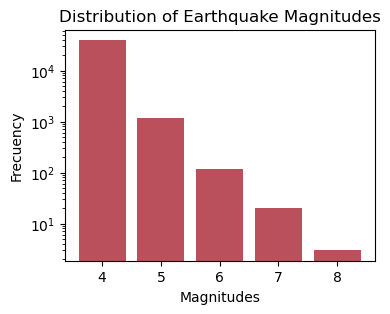

In [5]:
# Graph
uniques_magnitudes = sorted(df["magnitude_round"].unique())
c= "#B9505C"
plt.figure(figsize=(4, 3))
plt.bar(uniques_magnitudes,counts_per_magnitude, color=c)
# It is necessary to use a logarithmic scale since the records on scale 4 exceed 39,000 entries.
plt.yscale('log')
plt.xlabel("Magnitudes")
plt.ylabel("Frecuency")
plt.title("Distribution of Earthquake Magnitudes")
plt.show()

The largest number of recorded earthquakes are magnitude 4 with more than 39,000 records, while the smallest number is magnitude 8 with just 3 records.

**Now let's see the count of earthquakes recorded per years**

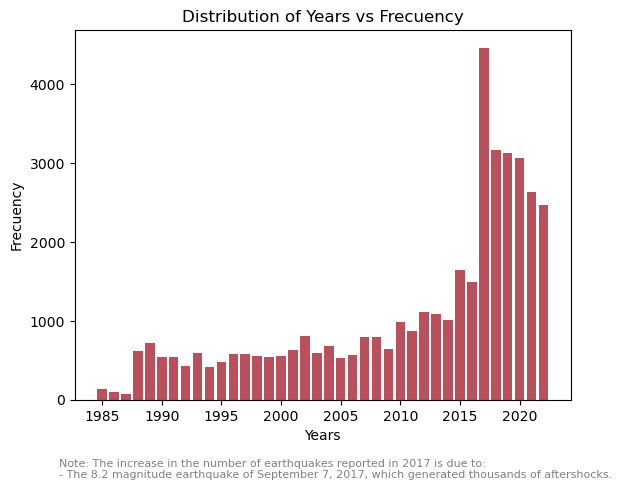

In [6]:
count_per_years = df['date'].dt.year.value_counts()
count_per_years = count_per_years.sort_index()
plt.bar(count_per_years.index, count_per_years.values, color=c)
plt.xlabel("Years")
plt.ylabel("Frecuency")
plt.title("Distribution of Years vs Frecuency")

note = """Note: The increase in the number of earthquakes reported in 2017 is due to:
- The 8.2 magnitude earthquake of September 7, 2017, which generated thousands of aftershocks."""
plt.figtext(0.1, -0.05, note, wrap=True,  horizontalalignment='left',fontsize=8, color='gray')

plt.show()

*The increase in records in 2017 is attributed to the thousands of aftershocks generated by the 8.2 magnitude earthquake on September 7.  
Starting in 2015 and 2018, the number of records per year increased due to the increase in the number of monitoring stations.*  


From 1988 to 2015, we can observe an increase in the number of earthquakes. Comparing the 536 in 1988 vs the 1004 in 2014 (almost double)  

**Let's see what the trends look like comparing the months vs numbers**

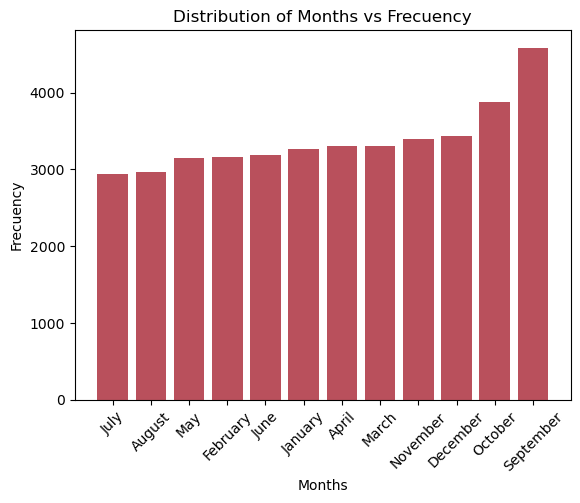

In [7]:
df['Month'] = (pd.to_datetime(df['date']).dt.month_name(locale='us_US.utf8'))
count_per_months =  df['Month'].value_counts().sort_values()
plt.bar(count_per_months.index, count_per_months.values, color=c)
plt.xlabel("Months")
plt.xticks(rotation=45)
plt.ylabel("Frecuency")
plt.title("Distribution of Months vs Frecuency")
plt.show()

Is interesting to note how September is by far the month with the most earthquake records.

- **Now let's see what the trends look like comparing the magnitude vs depth**

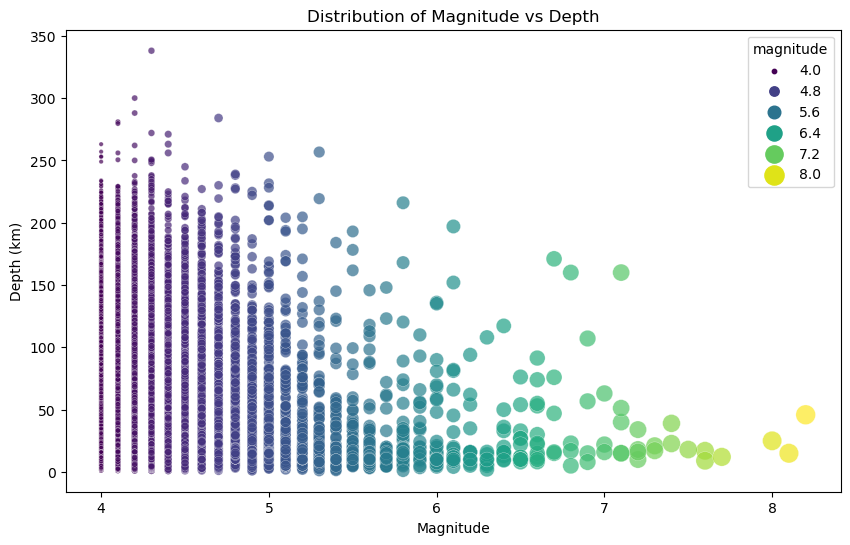

In [8]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='magnitude', y='depth', data=df, hue='magnitude', palette='viridis', size='magnitude', sizes=(10, 200), alpha=0.7)
plt.title('Distribution of Magnitude vs Depth')
plt.xlabel("Magnitude")
plt.ylabel('Depth (km)')
plt.show()

We observe a correlation where at shallower depths, there is a higher magnitude.


- **Now let's consider the recorded coordinates of each earthquake to identify the main zones on a map.**

In [9]:
filtered_map = folium.Map(location=[np.mean(df["latitude"]), np.mean(df["longitude"])], zoom_start=4)
marker_cluster = MarkerCluster().add_to(filtered_map)

for index, row in df.iterrows():
    latitude, longitude = float(row['latitude']), float(row['longitude'])
    folium.Marker([latitude, longitude],
                  popup=f"Magnitude: {row['magnitude']:.2f}, Date: {row['date'].strftime('%Y-%m-%d')}").add_to(marker_cluster)

filtered_map

As we can observe, there is a certain trend regarding the high number of earthquake records along the coasts of Acapulco, Oaxaca, and Chiapas. This is due to the convergence of three tectonic plates in this area: Cocos, Caribbean, and North American plates, making it points of high seismic activity.  
<img src="Tectonic_plates_Caribbean.png" alt="Map" width="40%">


## Final Question

**Do the earthquakes that have occurred on September 19 in Mexico show any distinctive patterns in terms of magnitude and depth, and is there evidence supporting the belief that this date has a higher likelihood of major seismic events?**

Analyzing the earthquakes on this date, including notable events in 1985, 2017, and 2022, we sought to uncover any patterns in dates, magnitudes and depths.  
Appears to be variation in the depths of these earthquakes. This recurring magnitude pattern raises questions about the potential factors contributing to the temporal clustering of major earthquakes on September 19.